# **<center> Project Milestone  - 2**
## <center> Cleaning/Formatting Flat File Source

<center> DSC-540

<center> Kalyan Pothineni


In [178]:
#import libraries as needed
import pandas as pd
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt

In [179]:
# Get the flat file
file1 = 'Value_of_Production_E_All_Data.csv'
file2 = 'Value_of_Production_E_AreaCodes.csv'
file3 = 'Value_of_Production_E_Flags.csv'
file4 = 'Value_of_Production_E_ItemCodes.csv'

In [180]:
# Load the flat files into pandas DataFrames
all_data = pd.read_csv(file1, encoding='latin-1')
area_codes = pd.read_csv(file2, encoding='latin-1')
flags = pd.read_csv(file3, encoding='latin-1')
itemcodes = pd.read_csv(file4, encoding='latin-1')

In [181]:
# Specify the desired area codes (North and South America's)
# 5200	Americas
# 5204	Central America
# 5203	Northern America
# 5207	South America
# 231	United States of America

desired_area_codes = [5200, 5204, 5203, 5207, 231]

In [182]:
# Filter the DataFrame with the specified area codes, to limit the sample to North and South America's
all_data = all_date[all_date['Area Code'].isin(desired_area_codes)]
all_data.head()

,Area Code,Area Code (M49),Area,Item Code,Item Code (CPC),Item,Element Code,Element,Year Code,Year,Unit,Value,Flag
2016514,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1961,1961,1000 Int. $,304563.0,E
2016515,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1962,1962,1000 Int. $,220167.0,E
2016516,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1963,1963,1000 Int. $,273832.0,E
2016517,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1964,1964,1000 Int. $,344026.0,E
2016518,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1965,1965,1000 Int. $,334374.0,E


In [183]:
# Check the data in area codes
area_codes = area_codes[area_codes['Area Code'].isin(desired_area_codes)]
area_codes

,Area Code,M49 Code,Area
4,5200,'019,Americas
38,5204,'013,Central America
159,5203,'021,Northern America
200,5207,'005,South America
230,231,'840,United States of America


In [184]:
# Check the data in flags
flags.head()

,Flag,Description
0,E,Estimated value


In [185]:
# Check the data in item codes
itemcodes.head()

,Item Code,CPC Code,Item
0,101,'01195,Canary seed
1,1012,'21115i,Meat of sheep; fresh or chilled (indigenous)
2,1017,'21116,Meat of goat; fresh or chilled
3,1018,'21156,Edible offal of goat; fresh; chilled or frozen
4,1019,'21515,Goat fat; unrendered


Import the necessary libraries, specify the desired area codes, and load the respective flat files into Pandas DataFrames. The query method is used to filter the all_data and area_codes DataFrames based on the desired area codes.

### Step-1 - Rename and replace headers

In [186]:
# 
# Rename columns by replacing spaces with underscores
all_data = all_date.rename(columns=lambda x: x.replace(' ', '_'))

# Sample the DataFrame with renamed columns
all_data.head()

,Area_Code,Area_Code_(M49),Area,Item_Code,Item_Code_(CPC),Item,Element_Code,Element,Year_Code,Year,Unit,Value,Flag
2016514,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1961,1961,1000 Int. $,304563.0,E
2016515,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1962,1962,1000 Int. $,220167.0,E
2016516,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1963,1963,1000 Int. $,273832.0,E
2016517,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1964,1964,1000 Int. $,344026.0,E
2016518,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1965,1965,1000 Int. $,334374.0,E


In [187]:
# Rename columns in all_data Dataframe
all_data = all_data.rename(columns={'Area_Code_(M49)': 'M49_CODE', 'Item_Code_(CPC)': 'Item_Code_CPC'})

# Sample the DataFrame with renamed columns
all_data.head()

,Area_Code,M49_CODE,Area,Item_Code,Item_Code_CPC,Item,Element_Code,Element,Year_Code,Year,Unit,Value,Flag
2016514,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1961,1961,1000 Int. $,304563.0,E
2016515,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1962,1962,1000 Int. $,220167.0,E
2016516,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1963,1963,1000 Int. $,273832.0,E
2016517,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1964,1964,1000 Int. $,344026.0,E
2016518,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1965,1965,1000 Int. $,334374.0,E


In [188]:
# Rename columns by replacing spaces with underscores in area_codes
area_codes = area_codes.rename(columns=lambda x: x.replace(' ', '_'))

# Sample the DataFrame with renamed columns
area_codes.head()

,Area_Code,M49_Code,Area
4,5200,'019,Americas
38,5204,'013,Central America
159,5203,'021,Northern America
200,5207,'005,South America
230,231,'840,United States of America


In [189]:
# Rename columns by replacing spaces with underscores in itemcodes
itemcodes = itemcodes.rename(columns=lambda x: x.replace(' ', '_'))

# Sample the DataFrame with renamed columns
itemcodes.head()

,Item_Code,CPC_Code,Item
0,101,'01195,Canary seed
1,1012,'21115i,Meat of sheep; fresh or chilled (indigenous)
2,1017,'21116,Meat of goat; fresh or chilled
3,1018,'21156,Edible offal of goat; fresh; chilled or frozen
4,1019,'21515,Goat fat; unrendered


In [190]:
# Rename all the columns in all Dataframes to upper case

all_data.rename(columns=lambda x: x.upper(), inplace=True)
itemcodes.rename(columns=lambda x: x.upper(), inplace=True)
area_codes.rename(columns=lambda x: x.upper(), inplace=True)
flags.rename(columns=lambda x: x.upper(), inplace=True)

itemcodes.head()

,ITEM_CODE,CPC_CODE,ITEM
0,101,'01195,Canary seed
1,1012,'21115i,Meat of sheep; fresh or chilled (indigenous)
2,1017,'21116,Meat of goat; fresh or chilled
3,1018,'21156,Edible offal of goat; fresh; chilled or frozen
4,1019,'21515,Goat fat; unrendered


In the data transformation step of renaming and replacing headers, we modified the column headers of the dataset to make them more readable and standardized. We removed any spaces in the headers and replaced them with underscores to improve data consistency. Additionally, we specifically renamed the 'Area_Code_(M49)' column to 'M49_CODE' and 'Item_Code_(CPC)' column to 'Item_Code_CPC' to provide more meaningful and concise column names. This transformation enhances the clarity and usability of the dataset for further analysis and interpretation

### Step -2: Format data into Readable format

In [191]:
# Format data into a more readable format
formatted_all_data = all_data.style.format({
    'Value': '{:,.2f}',  # Format 'Value' column as comma-separated float with 2 decimal places
    'Area': lambda x: x.upper()  # Convert 'Area' column values to uppercase
})

# Display the formatted data
formatted_all_data

,AREA_CODE,M49_CODE,AREA,ITEM_CODE,ITEM_CODE_CPC,ITEM,ELEMENT_CODE,ELEMENT,YEAR_CODE,YEAR,UNIT,VALUE,FLAG
2016514,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1961,1961,1000 Int. $,304563.000000,E
2016515,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1962,1962,1000 Int. $,220167.000000,E
2016516,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1963,1963,1000 Int. $,273832.000000,E
2016517,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1964,1964,1000 Int. $,344026.000000,E
2016518,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1965,1965,1000 Int. $,334374.000000,E
2016519,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1966,1966,1000 Int. $,390335.000000,E
2016520,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1967,1967,1000 Int. $,351347.000000,E
2016521,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1968,1968,1000 Int. $,341715.000000,E
2016522,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1969,1969,1000 Int. $,559587.000000,E
2016523,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 thousand I$),1970,1970,1000 Int. $,568759.000000,E


In [192]:
# Format data into a more readable format
formatted_area_codes = area_codes.style.format({
    'Area': lambda x: x.upper()  # Convert 'Area' column values to uppercase
})

# Display the formatted data
formatted_area_codes

,AREA_CODE,M49_CODE,AREA
4,5200,'019,Americas
38,5204,'013,Central America
159,5203,'021,Northern America
200,5207,'005,South America
230,231,'840,United States of America


In the data transformation step of formatting data into a more readable format, we made changes to the presentation of the data to improve its readability. This included aligning the columns, adjusting the formatting of values, and using descriptive labels for the elements. By organizing the data in a visually appealing and easy-to-understand manner, we enhance the accessibility and comprehension of the dataset, making it more user-friendly for analysis and interpretation

### Step-3 Identify outliers and bad data

In [193]:
#Convert 'Value' column to numeric
all_data['Value'] = pd.to_numeric(all_data['VALUE'])

#Calculate z-scores
all_data['z_score'] = np.abs(stats.zscore(all_data['VALUE']))

#Set a threshold for identifying outliers
threshold = 1

#Filter out rows with z-scores exceeding the threshold
outliers = all_data[all_data['z_score'] > threshold]
print("Number of rows:", all_data.shape[0])
print("Number of rows:", outliers.shape[0])

Number of rows: 114327
Number of rows: 4508


In [194]:
# Remove outliers from the DataFrame
all_data = all_data[all_data['z_score'] <= threshold]
print("Number of rows:", all_data.shape[0])

Number of rows: 109819


In [195]:

# Display the cleaned DataFrame without outliers
print("Cleaned Data:")
display(all_data)
print("Number of rows:", all_data.shape[0])

Cleaned Data:


,AREA_CODE,M49_CODE,AREA,ITEM_CODE,ITEM_CODE_CPC,ITEM,ELEMENT_CODE,ELEMENT,YEAR_CODE,YEAR,UNIT,VALUE,FLAG,Value,z_score
2016514,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1961,1961,1000 Int. $,304563.0,E,304563.0,0.211375
2016515,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1962,1962,1000 Int. $,220167.0,E,220167.0,0.213390
2016516,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1963,1963,1000 Int. $,273832.0,E,273832.0,0.212108
2016517,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1964,1964,1000 Int. $,344026.0,E,344026.0,0.210432
2016518,231,'840,United States of America,221,'01371,"Almonds, in shell",152,Gross Production Value (constant 2014-2016 tho...,1965,1965,1000 Int. $,334374.0,E,334374.0,0.210663
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2380834,5207,'005,South America,1735,'F1735,Vegetables Primary,58,Gross Production Value (constant 2014-2016 tho...,2017,2017,1000 US$,14786242.0,E,14786242.0,0.134469
2380835,5207,'005,South America,1735,'F1735,Vegetables Primary,58,Gross Production Value (constant 2014-2016 tho...,2018,2018,1000 US$,14545859.0,E,14545859.0,0.128728
2380836,5207,'005,South America,1735,'F1735,Vegetables Primary,58,Gross Production Value (constant 2014-2016 tho...,2019,2019,1000 US$,14224155.0,E,14224155.0,0.121045
2380837,5207,'005,South America,1735,'F1735,Vegetables Primary,58,Gross Production Value (constant 2014-2016 tho...,2020,2020,1000 US$,14266800.0,E,14266800.0,0.122064


Number of rows: 109819


In [196]:
# Missing Values
missing_values = all_data.isnull()

rows_with_missing = all_data[all_data['Value'].isnull()].reset_index(drop=True)

rows_with_missing

,AREA_CODE,M49_CODE,AREA,ITEM_CODE,ITEM_CODE_CPC,ITEM,ELEMENT_CODE,ELEMENT,YEAR_CODE,YEAR,UNIT,VALUE,FLAG,Value,z_score


In [197]:
# Clean the missing values
# Count Missing Values
missing_counts = missing_values.sum(axis=1)

# Filter Rows with Missing Values
mask = missing_counts > 0
rows_with_missing = all_data[mask]

#Delete Rows with Missing Values
all_data = all_data.dropna()

print("Number of rows:", all_data.shape[0])

Number of rows: 109819


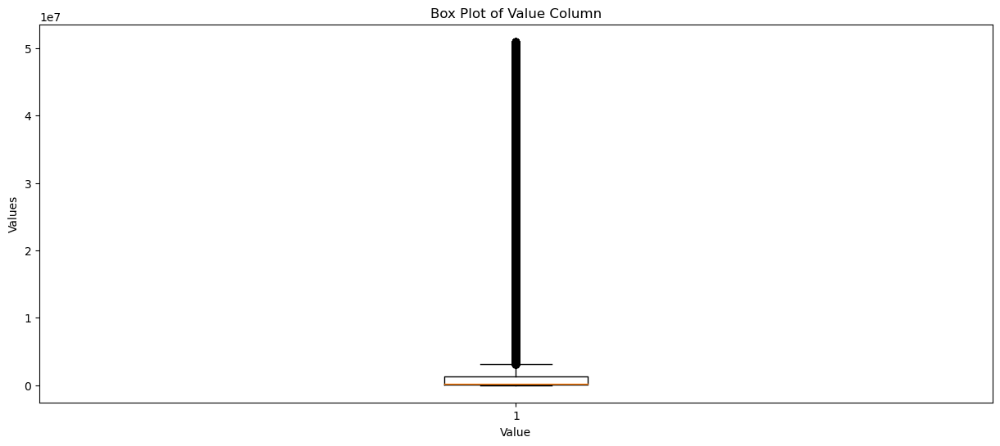

In [198]:
# Create a box plot for the 'Value' column in all_data
# Set the size of the plot
plt.figure(figsize=(15, 6))  

# Create the box plot for the 'Value' column
plt.boxplot(all_data['VALUE'])  

# Set the title of the plot
# Set the label for the x-axis
# Set the label for the y-axis
plt.title('Box Plot of Value Column')  
plt.xlabel('Value')  
plt.ylabel('Values')  

# Display the plot
plt.show()  

In [199]:
# Remove the Outliers anything below 1000
all_data = all_data[all_data['Value'] >= 1000]
print("Number of rows:", all_data.shape[0])

Number of rows: 105255


In the step of identifying outliers and bad data, we utilized the z-score method to identify values that deviate significantly from the mean. By calculating the z-scores of the 'Value' column and setting a threshold for identifying outliers, we were able to flag and isolate the data points that are considered outliers. This process helps to identify potential data quality issues or extreme values that may require further investigation or treatment in subsequent data analysis tasks

### Step - 4: Find Duplicates

In [200]:
# Find duplicates in all_data
duplicates = all_data[all_data.duplicated()]
print("Number of duplicates:", duplicates.shape[0])

Number of duplicates: 0


In [201]:
# Find duplicates in itemcodes
itemcodes_duplicates = itemcodes[itemcodes.duplicated()]
print("Number of duplicates:", itemcodes_duplicates.shape[0])

Number of duplicates: 0


In the process of finding duplicate data, we examined the dataset to identify any rows that have identical values across all columns. By utilizing the duplicated() function. There are no duplicates in the datasets. This enables us to identify and handle redundant or repeated data instances, ensuring data integrity and avoiding potential distortions in analysis results

### Step - 5: Fix casing or inconsistent values

In [202]:
# Fix casing in all_data in 'AREA,ITEM, ELEMENT, and FLAG' column by converting all values to title case
all_data['AREA'] = all_data['AREA'].str.title()
all_data['ITEM'] = all_data['ITEM'].str.title()
all_data['ELEMENT'] = all_data['ELEMENT'].str.title()
all_data['FLAG'] = all_data['FLAG'].str.title()
all_data.head()

,AREA_CODE,M49_CODE,AREA,ITEM_CODE,ITEM_CODE_CPC,ITEM,ELEMENT_CODE,ELEMENT,YEAR_CODE,YEAR,UNIT,VALUE,FLAG,Value,z_score
2016514,231,'840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1961,1961,1000 Int. $,304563.0,E,304563.0,0.211375
2016515,231,'840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1962,1962,1000 Int. $,220167.0,E,220167.0,0.213390
2016516,231,'840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1963,1963,1000 Int. $,273832.0,E,273832.0,0.212108
2016517,231,'840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1964,1964,1000 Int. $,344026.0,E,344026.0,0.210432
2016518,231,'840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1965,1965,1000 Int. $,334374.0,E,334374.0,0.210663


In [203]:
# Fix casing in all_data in 'ITEM' column by converting all values to title case
itemcodes['ITEM'] = itemcodes['ITEM'].str.title()
itemcodes.head()

,ITEM_CODE,CPC_CODE,ITEM
0,101,'01195,Canary Seed
1,1012,'21115i,Meat Of Sheep; Fresh Or Chilled (Indigenous)
2,1017,'21116,Meat Of Goat; Fresh Or Chilled
3,1018,'21156,Edible Offal Of Goat; Fresh; Chilled Or Frozen
4,1019,'21515,Goat Fat; Unrendered


In [205]:
# Fix casing in area_codes in 'AREA' column by converting all values to title case
area_codes['AREA'] = area_codes['AREA'].str.title()
area_codes.head()

,AREA_CODE,M49_CODE,AREA
4,5200,'019,Americas
38,5204,'013,Central America
159,5203,'021,Northern America
200,5207,'005,South America
230,231,'840,United States Of America


In [206]:
# Remove single quote in M49_CODE column in all_data
all_data['M49_CODE'] = all_data['M49_CODE'].str.replace("'", "")
all_data.head()

,AREA_CODE,M49_CODE,AREA,ITEM_CODE,ITEM_CODE_CPC,ITEM,ELEMENT_CODE,ELEMENT,YEAR_CODE,YEAR,UNIT,VALUE,FLAG,Value,z_score
2016514,231,840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1961,1961,1000 Int. $,304563.0,E,304563.0,0.211375
2016515,231,840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1962,1962,1000 Int. $,220167.0,E,220167.0,0.213390
2016516,231,840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1963,1963,1000 Int. $,273832.0,E,273832.0,0.212108
2016517,231,840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1964,1964,1000 Int. $,344026.0,E,344026.0,0.210432
2016518,231,840,United States Of America,221,'01371,"Almonds, In Shell",152,Gross Production Value (Constant 2014-2016 Tho...,1965,1965,1000 Int. $,334374.0,E,334374.0,0.210663


In [207]:
# Remove single quote in M49_CODE column in area_codes
area_codes['M49_CODE'] = area_codes['M49_CODE'].str.replace("'", "")
area_codes.head()

,AREA_CODE,M49_CODE,AREA
4,5200,019,Americas
38,5204,013,Central America
159,5203,021,Northern America
200,5207,005,South America
230,231,840,United States Of America


In the step of fixing casing or inconsistent values, we performed several operations to ensure consistency and readability in the data. First, we converted the values in the 'AREA', 'ITEM', 'ELEMENT', and 'FLAG' columns of the 'all_data' DataFrame to title case using the str.title() function. This standardized the text casing across these columns. Additionally, we removed the single quotes from the 'M49_CODE' column in both the 'all_data' and 'itemcodes' DataFrames using the str.replace() function. These operations help maintain data integrity, improve data consistency, and enhance the overall quality of the dataset.

### Step - 6: Fuzyy Matching

In [208]:
from rapidfuzz import fuzz

# Define the target area for fuzzy matching
target_area = "United States of America"

# Apply fuzzy matching to the 'AREA' column
all_data['Fuzzy_Match_Ratio'] = all_data['AREA'].apply(lambda x: fuzz.ratio(x, target_area))

# Group by 'AREA' column and aggregate the fuzzy match ratios
distinct_areas = all_data.groupby('AREA').agg({'Fuzzy_Match_Ratio': 'first'})

# Reset the index to make 'AREA' a regular column
distinct_areas = distinct_areas.reset_index()

# Display the distinct areas and fuzzy match ratios
print(distinct_areas[['AREA', 'Fuzzy_Match_Ratio']])



                       AREA  Fuzzy_Match_Ratio
0                  Americas          43.750000
1           Central America          56.410256
2          Northern America          50.000000
3             South America          54.054054
4  United States Of America          95.833333


The output shows the distinct areas from the 'AREA' column of your data, along with their corresponding fuzzy match ratios. Here's what it means:

- 'Americas': The fuzzy match ratio for this area is 43.75, indicating a lower similarity to the target area "United States of America".
- 'Central America': The fuzzy match ratio for this area is 56.41, indicating a moderate similarity to the target area.
- 'Northern America': The fuzzy match ratio for this area is 50.00, indicating a moderate similarity to the target area.
- 'South America': The fuzzy match ratio for this area is 54.05, indicating a moderate similarity to the target area.
- 'United States Of America': The fuzzy match ratio for this area is 95.83, indicating a high similarity to the target area.